In [ ]:
!pip install plotly

In [ ]:
import plotly.express as px
import pandas as pd

# Definir datos de la familia
data = {
    'Nombre': ["Abuelo", "Padre", "Tío", "Hijo1", "Hijo2", "Primo1", "Primo2"],
    'Padre': ["", "Abuelo", "Abuelo", "Padre", "Padre", "Tío", "Tío"],
    'Valor': [1, 1, 1, 1, 1, 1, 1]
}

df = pd.DataFrame(data)

# Crear el mapa jerárquico familiar
fig = px.treemap(df, path=['Padre', 'Nombre'], values='Valor',
                 title="Mapa Jerárquico Familiar")

fig.update_traces(root_color="lightblue")
fig.update_layout(margin=dict(t=50, l=25, r=25, b=25))
fig.show()


In [ ]:
import networkx as nx

import matplotlib.pyplot as plt

# Crear un grafo vacío
G = nx.Graph()

# Añadir nodos (regiones)
regiones = ['Norte', 'Sur', 'Este', 'Oeste', 'Centro']
for region in regiones:
    G.add_node(region)

# Añadir aristas (ventas entre regiones) con pesos (cantidad de ventas)
ventas = [
    ('Norte', 'Sur', 10),
    ('Norte', 'Este', 15),
    ('Sur', 'Oeste', 5),
    ('Este', 'Oeste', 20),
    ('Centro', 'Norte', 25),
    ('Centro', 'Sur', 30),
    ('Centro', 'Este', 35),
    ('Centro', 'Oeste', 40)
]

for venta in ventas:
    G.add_edge(venta[0], venta[1], weight=venta[2])

# Dibujar el grafo
pos = nx.spring_layout(G)  # Posiciones de los nodos
edges = G.edges(data=True)

# Dibujar nodos
nx.draw_networkx_nodes(G, pos, node_size=700)

# Dibujar etiquetas de nodos
nx.draw_networkx_labels(G, pos, font_size=12, font_family='sans-serif')

# Dibujar aristas con pesos
nx.draw_networkx_edges(G, pos, edgelist=edges, width=2)
nx.draw_networkx_edge_labels(G, pos, edge_labels={(u, v): d['weight'] for u, v, d in edges})

# Mostrar el gráfico
plt.title("Gráfico de Redes de Ventas por Región")
plt.show()


In [ ]:

import plotly.graph_objects as go

edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.append(x0)
    edge_x.append(x1)
    edge_x.append(None)
    edge_y.append(y0)
    edge_y.append(y1)
    edge_y.append(None)

edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    hoverinfo='none',
    mode='lines')

node_x = []
node_y = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_x.append(y)

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers+text',
    hoverinfo='text',
    marker=dict(
        showscale=True,
        colorscale='YlGnBu',
        size=10,
        colorbar=dict(
            thickness=15,
            title='Cantidad de Ventas',
            xanchor='left',
            titleside='right'
        ),
    ),
    text=[f'{node}: {G.degree[node]} ventas' for node in G.nodes()])

fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                title='Gráfico Interactivo de Redes de Ventas por Región',
                titlefont_size=16,
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20,l=5,r=5,t=40),
                annotations=[ dict(
                    text="Ventas por Región",
                    showarrow=False,
                    xref="paper", yref="paper",
                    x=0.005, y=-0.002 ) ],
                xaxis=dict(showgrid=False, zeroline=False),
                yaxis=dict(showgrid=False, zeroline=False))
                )

fig.show()

In [ ]:
import networkx as nx

import matplotlib.pyplot as plt

# Crear un grafo vacío
G_personas = nx.Graph()

# Añadir nodos (personas)
# Añadir nodos (personas) con sus cargos
G_personas.add_node('Ana', cargo='CEO')
G_personas.add_node('Luis', cargo='CTO')
G_personas.add_node('Carlos', cargo='CFO')
G_personas.add_node('Marta', cargo='COO')
G_personas.add_node('Jorge', cargo='CMO')
G_personas.add_node('Lucía', cargo='HR Manager')
G_personas.add_node('Pedro', cargo='Sales Manager')
personas = ['Ana', 'Luis', 'Carlos', 'Marta', 'Jorge', 'Lucía', 'Pedro']
for persona in personas:
    G_personas.add_node(persona)

# Añadir aristas (conexiones entre personas)
conexiones = [
    ('Ana', 'Luis'),
    ('Ana', 'Carlos'),
    ('Luis', 'Marta'),
    ('Carlos', 'Jorge'),
    ('Marta', 'Lucía'),
    ('Jorge', 'Pedro'),
    ('Lucía', 'Pedro'),
    ('Pedro', 'Ana')
]

for conexion in conexiones:
    G_personas.add_edge(conexion[0], conexion[1])

# Dibujar el grafo
pos_personas = nx.spring_layout(G_personas)  # Posiciones de los nodos

# Dibujar nodos
nx.draw_networkx_nodes(G_personas, pos_personas, node_size=700)

# Dibujar etiquetas de nodos
nx.draw_networkx_labels(G_personas, pos_personas, font_size=12, font_family='sans-serif')

# Dibujar aristas
nx.draw_networkx_edges(G_personas, pos_personas, width=2)

# Mostrar el gráfico
plt.title("Gráfico de Redes de Conexión entre Personas")
plt.show()

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Cargar datos
data = {
    'EmployeeID': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14],
    'EmployeeName': ["Patty", "Carleen", "Jorden", "Madalina", "Evy", "Paul", "Mats", "Matthew", "Rob", "Twan", "Roel", "Luc", "Dirk", "Iris"],
    'ManagerID': [5, 5, 5, 5, 6, None, 6, 7, 7, 12, 12, 6, 12, 7],
    'ManagerName': ["Evy", "Evy", "Evy", "Evy", "Paul", "", "Paul", "Mats", "Mats", "Luc", "Luc", "Paul", "Luc", "Mats"],
    'EmployeeJobTitle': ["HR staff", "P&O officer", "Recruiter", "Secretary", "Manager", "CEO", "Manager", "Account Manager", "Account Manager", "Developer", "Developer", "Manager", "Consultant", "Account Manager"],
    'EmployeeDepartment': ["HR", "HR", "HR", "HR", "HR", "Board", "Sales", "Sales", "Sales", "IT", "IT", "IT", "IT", "Sales"],
    'EmployeeSalary': [43000, 45000, 50000, 30000, 80000, 220000, 110000, 80000, 85000, 55000, 65000, 90000, 70000, 81000]
}

df = pd.DataFrame(data)

# Asignar colores a cada departamento
department_colors = {
    "HR": "skyblue",
    "Board": "gold",
    "Sales": "lightgreen",
    "IT": "salmon"
}

# Crear el gráfico de redes
G = nx.DiGraph()  # Grafo dirigido para mostrar jerarquía

# Añadir nodos con atributos
for _, row in df.iterrows():
    G.add_node(row['EmployeeID'], 
               label=row['EmployeeName'], 
               title=row['EmployeeJobTitle'], 
               salary=row['EmployeeSalary'],
               department=row['EmployeeDepartment'],
               color=department_colors[row['EmployeeDepartment']])

# Añadir aristas (relaciones de jerarquía)
for _, row in df.iterrows():
    if pd.notna(row['ManagerID']):
        G.add_edge(row['ManagerID'], row['EmployeeID'])

# Crear la visualización
plt.figure(figsize=(12, 8))
pos = nx.spring_layout(G, seed=42)  # Disposición de los nodos

# Obtener colores por departamento
node_colors = [data['color'] for _, data in G.nodes(data=True)]

# Dibujar nodos
nx.draw_networkx_nodes(G, pos, node_size=3000, node_color=node_colors, edgecolors='black')

# Dibujar aristas
nx.draw_networkx_edges(G, pos, arrowstyle='->', arrowsize=15)

# Dibujar etiquetas para cada nodo
labels = {node: f"{data['label']}\n{data['department']}\n{data['title']}\n${data['salary']}" 
          for node, data in G.nodes(data=True)}
nx.draw_networkx_labels(G, pos, labels, font_size=8, font_weight='bold')

# Configuración adicional
plt.title("Gráfico de Redes de la Organización", fontsize=16)
plt.axis('off')
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Generar datos de ejemplo
np.random.seed(0)
months = ["Ene", "Feb", "Mar", "Abr", "May", "Jun", "Jul", "Ago", "Sep", "Oct", "Nov", "Dic"]
temperature = np.random.normal(15, 5, 12)  # Temperaturas promedio en °C
precipitation = np.random.normal(80, 20, 12)  # Precipitación promedio en mm

# Crear un DataFrame con los datos
data = pd.DataFrame({
    "Mes": months,
    "Temperatura": temperature,
    "Precipitacion": precipitation
})

# Crear el gráfico
fig, ax1 = plt.subplots(figsize=(10, 6))

# Gráfico de líneas para la temperatura
color = 'tab:red'
ax1.set_xlabel('Mes')
ax1.set_ylabel('Temperatura (°C)', color=color)
ax1.plot(data["Mes"], data["Temperatura"], color=color, marker='o', label="Temperatura")
ax1.tick_params(axis='y', labelcolor=color)

# Crear un segundo eje Y para la precipitación
ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('Precipitación (mm)', color=color)
ax2.bar(data["Mes"], data["Precipitacion"], color=color, alpha=0.3, label="Precipitación")
ax2.tick_params(axis='y', labelcolor=color)

# Añadir título y leyenda
fig.suptitle("Resumen Meteorológico Anual")
ax1.legend(loc="upper left")
ax2.legend(loc="upper right")

# Mostrar el gráfico
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Datos demo: Avance de la civilización en distintos aspectos a lo largo del tiempo
data = {
    "Año": [500, 1000, 1500, 1700, 1800, 1900, 1950, 2000, 2020],
    "Tecnología": [1, 2, 3, 5, 7, 15, 25, 80, 90],
    "Economía": [1, 3, 6, 10, 15, 30, 50, 85, 95],
    "Cultura": [2, 3, 5, 7, 9, 12, 18, 60, 80]
}

# Crear un DataFrame
df = pd.DataFrame(data)

# Definir los hitos tecnológicos
hitos = {
    500: "Invención del Papel",
    1500: "Imprenta de Gutenberg",
    1700: "Revolución Industrial",
    1900: "Electricidad Comercial",
    1950: "Inicio de la Computación",
    2000: "Internet Global",
    2020: "Inteligencia Artificial"
}

# Crear el gráfico
plt.figure(figsize=(12, 6))
plt.plot(df["Año"], df["Tecnología"], label="Tecnología", marker='o', color="blue")
plt.plot(df["Año"], df["Economía"], label="Economía", marker='o', color="green")
plt.plot(df["Año"], df["Cultura"], label="Cultura", marker='o', color="red")

# Añadir hitos como anotaciones
for year, label in hitos.items():
    plt.annotate(label, 
                 (year, df.loc[df["Año"] == year, "Tecnología"].values[0]), 
                 textcoords="offset points", 
                 xytext=(0,5), 
                 ha='center', 
                 fontsize=9,
                 color="blue",
                 arrowprops=dict(arrowstyle="->", color="gray"))

# Personalizar el gráfico
plt.title("Avance Histórico de la Civilización a lo Largo del Tiempo")
plt.xlabel("Año")
plt.ylabel("Nivel de Avance (Escala Relativa)")
plt.legend()
plt.grid(True)
plt.xticks(df["Año"], rotation=45)
plt.tight_layout()

# Mostrar el gráfico
plt.show()


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
import pandas as pd

# Cargar el dataset Iris
iris = load_iris()
df_iris = pd.DataFrame(data=iris.data, columns=iris.feature_names)
df_iris['species'] = pd.Categorical.from_codes(iris.target, iris.target_names)  # Convertir a nombres de especies

# Crear el gráfico de dispersión con seaborn
sns.pairplot(df_iris, hue="species", palette="viridis", diag_kind="kde")
plt.suptitle("Gráfico de dispersión del dataset Iris", y=1.02)  # Título principal
plt.show()


In [1]:
import pandas as pd


df = pd.read_excel('./datasets/SDG_0821_NOC_RT_A-20241103T0026.xlsx')

rename = {
    'ref_area.label':'pais', 
    'source.label': 'fuente', 
    'indicator.label':'tipo',
    'time':'year',
    'obs_value':'ratio'
}

df.rename(
    rename
    ,inplace=True, axis='columns')
df.head()

,pais,fuente,tipo,year,ratio
0,Angola,ILO - Modelled Estimates,SDG indicator 8.2.1 - Annual growth rate of ou...,2024,-0.319
1,Angola,ILO - Modelled Estimates,SDG indicator 8.2.1 - Annual growth rate of ou...,2023,-2.204
2,Angola,ILO - Modelled Estimates,SDG indicator 8.2.1 - Annual growth rate of ou...,2022,-0.616
3,Angola,ILO - Modelled Estimates,SDG indicator 8.2.1 - Annual growth rate of ou...,2021,-4.851
4,Angola,ILO - Modelled Estimates,SDG indicator 8.2.1 - Annual growth rate of ou...,2020,-8.737


In [ ]:
import seaborn as sns

import matplotlib.pyplot as plt

# Filtrar los datos para los países Angola, Argelia y Egipto
paises_interes = ['Angola', 'Algeria', 'Egypt']
df_filtrado = df[df['pais'].isin(paises_interes)]

# Crear el gráfico de líneas
plt.figure(figsize=(12, 6))
sns.lineplot(data=df_filtrado, x='year', y='ratio', hue='pais', marker='o')

# Personalizar el gráfico
# Añadir etiquetas importantes
for pais in paises_interes:
    max_ratio = df_filtrado[df_filtrado['pais'] == pais]['ratio'].max()
    year_max_ratio = df_filtrado[(df_filtrado['pais'] == pais) & (df_filtrado['ratio'] == max_ratio)]['year'].values[0]
    plt.text(year_max_ratio, max_ratio, f'{pais}: {max_ratio:.2f}', 
             horizontalalignment='right', size='medium', color='black', weight='semibold')

plt.xlim(left=2000)
plt.title("Ratio Anual por País")
plt.xlabel("Año")
plt.ylabel("Ratio")
plt.legend(title='País')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Mostrar el gráfico
plt.show()


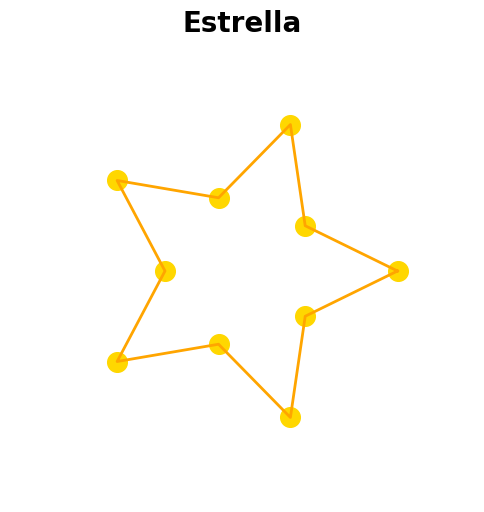

In [7]:
import matplotlib.pyplot as plt
import numpy as np

# Función para calcular los puntos de una estrella
def star_points(n_points=5, radius_outer=1, radius_inner=0.5):
    angles = np.linspace(0, 2 * np.pi, n_points * 2, endpoint=False)
    # Alternar entre el radio exterior e interior
    radius = np.array([radius_outer if i % 2 == 0 else radius_inner for i in range(n_points * 2)])
    x = radius * np.cos(angles)
    y = radius * np.sin(angles)
    return x, y

# Generar los puntos de la estrella
x, y = star_points(n_points=5)

# Crear el gráfico
plt.figure(figsize=(6, 6))
plt.scatter(x, y, color='gold', s=200)  # Puntos dorados para la estrella

# Conectar los puntos para formar la estrella
plt.plot(np.append(x, x[0]), np.append(y, y[0]), color='orange', linewidth=2)

# Personalizar el gráfico
plt.xlim(-1.5, 1.5)
plt.ylim(-1.5, 1.5)
plt.axis('off')  # Ocultar los ejes

# Mostrar el gráfico
plt.title("Estrella", fontsize=20, fontweight='bold')
plt.show()


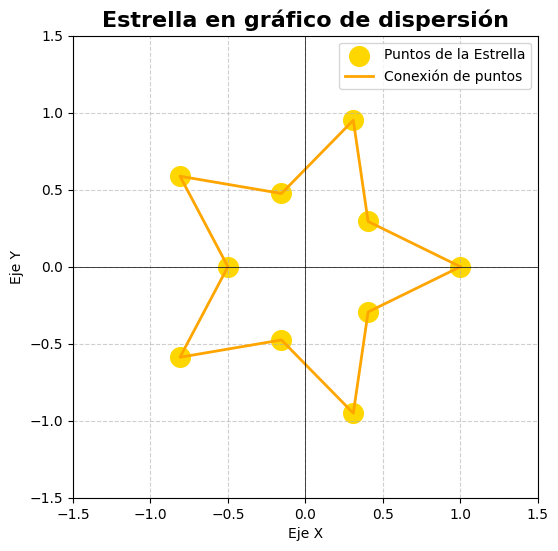

In [8]:
import matplotlib.pyplot as plt
import numpy as np

# Función para calcular los puntos de una estrella
def star_points(n_points=5, radius_outer=1, radius_inner=0.5):
    angles = np.linspace(0, 2 * np.pi, n_points * 2, endpoint=False)
    # Alternar entre el radio exterior e interior
    radius = np.array([radius_outer if i % 2 == 0 else radius_inner for i in range(n_points * 2)])
    x = radius * np.cos(angles)
    y = radius * np.sin(angles)
    return x, y

# Generar los puntos de la estrella
x, y = star_points(n_points=5)

# Crear el gráfico
plt.figure(figsize=(6, 6))
plt.scatter(x, y, color='gold', s=200, label='Puntos de la Estrella')  # Puntos dorados para la estrella

# Conectar los puntos para formar la estrella
plt.plot(np.append(x, x[0]), np.append(y, y[0]), color='orange', linewidth=2, label='Conexión de puntos')

# Personalizar el gráfico
plt.xlim(-1.5, 1.5)
plt.ylim(-1.5, 1.5)
plt.axhline(0, color='black',linewidth=0.5)
plt.axvline(0, color='black',linewidth=0.5)
plt.xlabel("Eje X")
plt.ylabel("Eje Y")
plt.grid(True, linestyle='--', alpha=0.6)

# Mostrar la leyenda y título
plt.legend()
plt.title("Estrella en gráfico de dispersión", fontsize=16, fontweight='bold')

# Mostrar el gráfico
plt.show()


In [ ]:
import pandas as pd


df = pd.read_csv('./datasets/sp500_stocks.csv')

Index(['Date', 'Symbol', 'Adj Close', 'Close', 'High', 'Low', 'Open',
       'Volume'],
      dtype='object')

In [14]:
# date

df['Date'] = pd.to_datetime(df['Date'])

df.dtypes

Date         datetime64[ns]
Symbol               object
Adj Close           float64
Close               float64
High                float64
Low                 float64
Open                float64
Volume              float64
dtype: object

In [17]:
df.Date.dt.year.unique()

array([2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022, 2023, 2024], dtype=int32)

In [18]:
import plotly.graph_objects as go

# Filtrar los datos para el año 2024
df_2024 = df[df['Date'].dt.year == 2024]

# Crear el gráfico de velas
fig = go.Figure(data=[go.Candlestick(x=df_2024['Date'],
                                     open=df_2024['Open'],
                                     high=df_2024['High'],
                                     low=df_2024['Low'],
                                     close=df_2024['Close'],
                                     name='Candlestick')])

# Agregar etiquetas para "Adj Close"
fig.add_trace(go.Scatter(x=df_2024['Date'], 
                         y=df_2024['Adj Close'], 
                         mode='markers+text', 
                         text=df_2024['Adj Close'],
                         textposition='top center',
                         name='Adj Close'))

# Configurar el layout del gráfico
fig.update_layout(title='Gráfico de Velas para el Año 2024',
                  xaxis_title='Fecha',
                  yaxis_title='Precio',
                  xaxis_rangeslider_visible=False)

# Mostrar el gráfico
fig.show()